In [1]:
import pandas as pd
import numpy as np

In [2]:
import altair as alt

In [3]:
lint_df = pd.read_csv("pylint_structured_python3.csv")
lint_df

,repository,type,module,obj,line,column,path,symbol,message,message-id
0,100073601,convention,setup,NaN,1,0,100073601/setup.py,missing-module-docstring,Missing module docstring,C0114
1,100073601,warning,setup,NaN,2,0,100073601/setup.py,redefined-builtin,Redefining built-in 'open',W0622
2,100073601,convention,setup,NaN,5,0,100073601/setup.py,invalid-name,"Constant name ""here"" doesn't conform to UPPER_...",C0103
3,100073601,convention,setup,NaN,9,4,100073601/setup.py,invalid-name,"Constant name ""long_description"" doesn't confo...",C0103
4,100073601,convention,setup,NaN,2,0,100073601/setup.py,wrong-import-order,"standard import ""from codecs import open"" shou...",C0411
...,...,...,...,...,...,...,...,...,...,...
434384,99785600,convention,data.arXiv.abstract_extract,NaN,34,0,99785600/data/arXiv/abstract_extract.py,invalid-name,"Constant name ""save_dir"" doesn't conform to UP...",C0103
434385,99785600,warning,data.arXiv.abstract_extract,NaN,48,3,99785600/data/arXiv/abstract_extract.py,bare-except,No exception type(s) specified,W0702
434386,99785600,error,data.arXiv.download,NaN,25,1,99785600/data/arXiv/download.py,syntax-error,"invalid syntax (&lt;unknown&gt;, line 25)",E0001
434387,99785600,refactor,data.arXiv.download,NaN,1,0,99785600/data/arXiv/download.py,duplicate-code,Similar lines in 2 files\n==code.data:206\n==c...,R0801


In [4]:
# https://stackoverflow.com/questions/36004976/count-frequency-of-values-in-pandas-dataframe-column
lint_df = lint_df.groupby(['repository', 'symbol'])['message-id'].describe()
lint_df

count unique    top freq
repository symbol                                                 
118130     assignment-from-no-return          2      1  E1111    2
           attribute-defined-outside-init    13      1  W0201   13
           bad-continuation                   6      1  C0330    6
           bad-indentation                    5      1  W0311    5
           bad-whitespace                   162      1  C0326  162
...                                         ...    ...    ...  ...
119537109  unused-wildcard-import            30      1  W0614   30
           useless-object-inheritance        21      1  R0205   21
           useless-return                     8      1  R1711    8
           wildcard-import                   11      1  W0401   11
           wrong-import-order                 3      1  C0411    3

[4454 rows x 4 columns]

In [5]:
# https://stackoverflow.com/questions/14507794/pandas-how-to-flatten-a-hierarchical-index-in-columns
lint_df = pd.DataFrame(lint_df.to_records())

In [6]:
lint_df

,repository,symbol,count,unique,top,freq
0,118130,assignment-from-no-return,2,1,E1111,2
1,118130,attribute-defined-outside-init,13,1,W0201,13
2,118130,bad-continuation,6,1,C0330,6
3,118130,bad-indentation,5,1,W0311,5
4,118130,bad-whitespace,162,1,C0326,162
...,...,...,...,...,...,...
4449,119537109,unused-wildcard-import,30,1,W0614,30
4450,119537109,useless-object-inheritance,21,1,R0205,21
4451,119537109,useless-return,8,1,R1711,8
4452,119537109,wildcard-import,11,1,W0401,11


In [7]:
lint_df.sort_values(['count'], ascending=False)

,repository,symbol,count,unique,top,freq
3902,104676745,bad-whitespace,135282,1,C0326,135282
288,3546355,bad-continuation,60316,1,C0330,60316
1829,43172794,invalid-name,19626,1,C0103,19626
3894,104676745,bad-continuation,16380,1,C0330,16380
3938,104676745,invalid-name,9000,1,C0103,9000
...,...,...,...,...,...,...
1946,45241467,keyword-arg-before-vararg,1,1,W1113,1
1949,45241467,missing-final-newline,1,1,C0304,1
1952,45241467,multiple-imports,1,1,C0410,1
1953,45241467,no-else-return,1,1,R1705,1


In [8]:
lint_df2 = lint_df[['repository', 'symbol']].copy()

In [9]:
lint_df2['cnt'] = lint_df['count'].map(lambda x : int(x)) # workaround bug in Altair with JavaScript integer representation

In [10]:
lint_df2.columns

Index(['repository', 'symbol', 'cnt'], dtype='object')

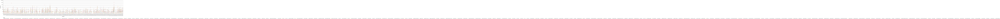

In [11]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('symbol', legend=alt.Legend(title="symbol", orient="bottom"))
)
chart

In [12]:
chart.save("symbol-issue-count.png")

In [13]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2).mark_point().encode(
    x = alt.X('symbol', type='ordinal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('repository', type='nominal', legend=alt.Legend(title="repository", orient="bottom"))
)

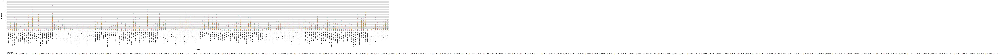

In [14]:
chart

In [15]:
chart.save("count-of-each-pylint-violation-type-for-each-repository.png")

In [16]:
lint_df2

,repository,symbol,cnt
0,118130,assignment-from-no-return,2
1,118130,attribute-defined-outside-init,13
2,118130,bad-continuation,6
3,118130,bad-indentation,5
4,118130,bad-whitespace,162
...,...,...,...
4449,119537109,unused-wildcard-import,30
4450,119537109,useless-object-inheritance,21
4451,119537109,useless-return,8
4452,119537109,wildcard-import,11


In [17]:
import_sets_df_simp = pd.read_csv("../../notebooks/import_sets_df_simp.csv")

In [18]:
import_sets_df_simp

,repo,isML
0,759484,True
1,2240410,False
2,3129447,False
3,3255194,False
4,3546355,False
...,...,...
84,111696541,True
85,112664267,True
86,114098658,True
87,118248283,True


In [19]:
import_sets_df_simp["isML"].describe()

count       89
unique       2
top       True
freq        55
Name: isML, dtype: object

In [158]:
lint_df2merged = lint_df2.merge(import_sets_df_simp, left_on='repository', right_on='repo')

In [21]:
lint_df2merged

,repository,symbol,cnt,repo,isML
0,2240410,anomalous-backslash-in-string,11,2240410,False
1,2240410,attribute-defined-outside-init,4,2240410,False
2,2240410,bad-continuation,1,2240410,False
3,2240410,bad-indentation,1,2240410,False
4,2240410,bad-whitespace,1,2240410,False
...,...,...,...,...,...
2530,119537109,unused-wildcard-import,30,119537109,True
2531,119537109,useless-object-inheritance,21,119537109,True
2532,119537109,useless-return,8,119537109,True
2533,119537109,wildcard-import,11,119537109,True


In [22]:
# Will fail, because currently only analysing Py3
# If fails, means not all repos were in import sets.
assert len(lint_df2merged) == len(import_sets_df_simp)

AssertionError: 

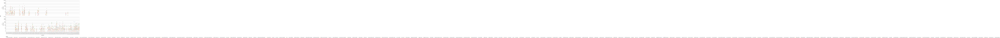

In [23]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2merged).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('symbol', legend=alt.Legend(title="symbol", orient="bottom")),
    row = 'isML'
)
chart

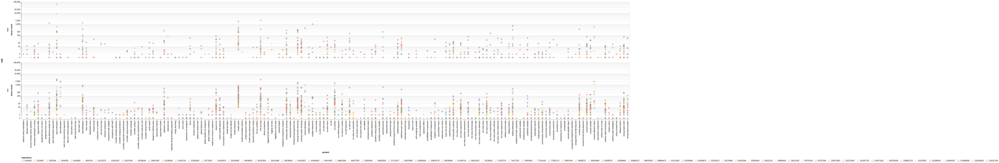

In [24]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2merged).mark_point().encode(
    x = alt.X('symbol', type='ordinal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('repository', type='nominal', legend=alt.Legend(title="repository", orient="bottom")),
    row = 'isML'
)
chart

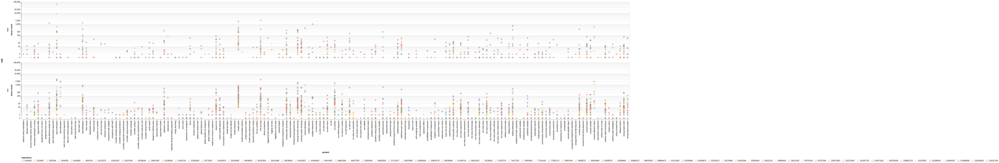

In [25]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2merged).mark_point().encode(
    x = alt.X('symbol', type='ordinal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('repository', type='nominal', legend=alt.Legend(title="repository", orient="bottom")),
    row = 'isML'
)
chart

In [26]:
# todo: Run MANOVA as (frequentist) test of statistical significance 

In [27]:
# https://www.statsmodels.org/stable/examples/notebooks/generated/interactions_anova.html (see treatment example at end of page)

In [28]:
from statsmodels.formula.api import ols
from statsmodels.graphics.api import interaction_plot, abline_plot
from statsmodels.stats.anova import anova_lm

In [29]:
lint_df2merged

,repository,symbol,cnt,repo,isML
0,2240410,anomalous-backslash-in-string,11,2240410,False
1,2240410,attribute-defined-outside-init,4,2240410,False
2,2240410,bad-continuation,1,2240410,False
3,2240410,bad-indentation,1,2240410,False
4,2240410,bad-whitespace,1,2240410,False
...,...,...,...,...,...
2530,119537109,unused-wildcard-import,30,119537109,True
2531,119537109,useless-object-inheritance,21,119537109,True
2532,119537109,useless-return,8,119537109,True
2533,119537109,wildcard-import,11,119537109,True


In [30]:
# http://md.psych.bio.uni-goettingen.de/mv/unit/lm_cat/lm_cat_unbal_ss_explained.html
# Type 1:
#    SS(A) for factor A. 
#    SS(B | A) for factor B. 
#    SS(AB | B, A) for interaction AB. 
#
# Because of the sequential nature and the fact that the two main factors are tested in a particular order,
# this type of sums of squares will give different results for unbalanced data depending on which main effect is considered first.
#
# For unbalanced data, this approach tests for a difference in the weighted marginal means.
# In practical terms, this means that the results are dependent on the realized sample sizes, namely the proportions in the particular data set.
# In other words, it is testing the first factor without controlling for the other factor (for further discussion and a worked example, see Zahn [4]). 

# We test for symbol first (as this is expected to have the greatest effect), then look at isML|symbol and interactions
# Data set is (reasonably) ballanced (same number of observations in each group), so tests should be equivalent (but aren't)
# (Problem: need to include 0s for errors that don't occur)

# https://www.statsmodels.org/stable/examples/notebooks/generated/interactions_anova.html
nosum_lm = ols('np.log(cnt+1) ~ C(symbol, Sum) * C(isML, Sum)',
            data=lint_df2merged).fit()

In [31]:
nosum_lm

In [32]:
print(anova_lm(nosum_lm)) # Most meaningful

                                 df       sum_sq    mean_sq         F  \
C(symbol, Sum)                163.0  1758.908338  10.790849  8.000566   
C(isML, Sum)                    1.0    10.220840  10.220840  7.577950   
C(symbol, Sum):C(isML, Sum)   163.0   256.930789   1.576263  1.168675   
Residual                     2252.0  3037.408894   1.348761       NaN   

                                    PR(>F)  
C(symbol, Sum)               4.559371e-132  
C(isML, Sum)                  5.956057e-03  
C(symbol, Sum):C(isML, Sum)   7.746945e-02  
Residual                               NaN  


In [33]:
print(anova_lm(nosum_lm, typ=2))

                                   sum_sq      df          F    PR(>F)
C(symbol, Sum)               15390.423556   163.0  70.004844  0.000000
C(isML, Sum)                     7.512793     1.0   5.570146  0.018354
C(symbol, Sum):C(isML, Sum)    180.397932   163.0   0.820558  0.949718
Residual                      3037.408894  2252.0        NaN       NaN


/home/andrew/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:1752: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 163, but rank is 120
  'rank is %d' % (J, J_), ValueWarning)


In [34]:
print(anova_lm(nosum_lm, typ=3))

                                  sum_sq      df            F         PR(>F)
Intercept                    1652.585014     1.0  1225.261919  1.024339e-214
C(symbol, Sum)               1354.246851   163.0     6.159924   5.265165e-95
C(isML, Sum)                    2.625834     1.0     1.946850   1.630643e-01
C(symbol, Sum):C(isML, Sum)   180.397932   163.0     0.820558   9.497184e-01
Residual                     3037.408894  2252.0          NaN            NaN


Conclusion: difference between symbols is (unsurprisingly) significant. Effect of isML is significant at 0.006 (type 1), 0.02 (type 2) or 0.2 (type 3).

Should we have run a MANOVA instead?
https://www.statisticssolutions.com/directory-of-statistical-analyses-manova-analysis/
https://www.researchgate.net/post/What_is_the_difference_between_ANOVA_MANOVA
(Yes -- MANOVA would be prefereable)


In [35]:
# See https://www.marsja.se/python-manova-made-easy-using-statsmodels/ for tutorial on MANOVA in Python

In [36]:
import math

In [37]:
lint_df2merged_log = lint_df2merged.copy()
lint_df2merged_log["cnt"] = np.log(lint_df2merged_log["cnt"] + 1) # log transform

In [38]:
lint_df2mergedpivot = lint_df2merged_log[["repository", "isML", "symbol", "cnt"]].pivot_table(index=["repository", "isML"], columns="symbol")
lint_df2mergedpivot

cnt                  \
symbol           abstract-class-instantiated abstract-method   
repository isML                                                
2240410    False                         NaN             NaN   
3129447    False                         NaN             NaN   
3255194    False                         NaN             NaN   
3546355    False                         NaN             NaN   
8194692    False                         NaN             NaN   
...                                      ...             ...   
111696541  True                          NaN             NaN   
112664267  True                          NaN        1.098612   
114098658  True                          NaN             NaN   
118248283  True                          NaN        1.098612   
119537109  True                          NaN             NaN   

                                                  \
symbol           access-member-before-definition   
repository isML                                    
2240410    False                             NaN   
3129447    False                             NaN   
3255194    False                             NaN   
3546355    False                             NaN   
8194692    False                             NaN   
...                                          ...   
111696541  True                              NaN   
112664267  True                              NaN   
114098658  True                              NaN   
118248283  True                              NaN   
119537109  True                              NaN   

                                                                 \
symbol           anomalous-backslash-in-string arguments-differ   
repository isML                                                   
2240410    False                      2.484907              NaN   
3129447    False                           NaN              NaN   
3255194    False                           NaN              NaN   
3546355    False                      1.098612              NaN   
8194692    False                           NaN              NaN   
...                                        ...              ...   
111696541  True                            NaN              NaN   
112664267  True                       2.564949         3.401197   
114098658  True                       2.397895         3.555348   
118248283  True                       1.098612         2.772589   
119537109  True                            NaN         2.397895   

                                                                 \
symbol           assignment-from-no-return assignment-from-none   
repository isML                                                   
2240410    False                       NaN                  NaN   
3129447    False                       NaN                  NaN   
3255194    False                       NaN                  NaN   
3546355    False                       NaN                  NaN   
8194692    False                       NaN                  NaN   
...                                    ...                  ...   
111696541  True                        NaN                  NaN   
112664267  True                   1.098612                  NaN   
114098658  True                        NaN                  NaN   
118248283  True                        NaN                  NaN   
119537109  True                        NaN                  NaN   

                                                                          \
symbol           attribute-defined-outside-init bad-classmethod-argument   
repository isML                                                            
2240410    False                       1.609438                      NaN   
3129447    False                            NaN                      NaN   
3255194    False                       2.079442                      NaN   
3546355    False                            NaN                      NaN   
81946

In [39]:
lint_df2mergedpivot_clean = lint_df2mergedpivot.fillna(value = 0)
lint_df2mergedpivot_clean

cnt                  \
symbol           abstract-class-instantiated abstract-method   
repository isML                                                
2240410    False                         0.0        0.000000   
3129447    False                         0.0        0.000000   
3255194    False                         0.0        0.000000   
3546355    False                         0.0        0.000000   
8194692    False                         0.0        0.000000   
...                                      ...             ...   
111696541  True                          0.0        0.000000   
112664267  True                          0.0        1.098612   
114098658  True                          0.0        0.000000   
118248283  True                          0.0        1.098612   
119537109  True                          0.0        0.000000   

                                                  \
symbol           access-member-before-definition   
repository isML                                    
2240410    False                             0.0   
3129447    False                             0.0   
3255194    False                             0.0   
3546355    False                             0.0   
8194692    False                             0.0   
...                                          ...   
111696541  True                              0.0   
112664267  True                              0.0   
114098658  True                              0.0   
118248283  True                              0.0   
119537109  True                              0.0   

                                                                 \
symbol           anomalous-backslash-in-string arguments-differ   
repository isML                                                   
2240410    False                      2.484907         0.000000   
3129447    False                      0.000000         0.000000   
3255194    False                      0.000000         0.000000   
3546355    False                      1.098612         0.000000   
8194692    False                      0.000000         0.000000   
...                                        ...              ...   
111696541  True                       0.000000         0.000000   
112664267  True                       2.564949         3.401197   
114098658  True                       2.397895         3.555348   
118248283  True                       1.098612         2.772589   
119537109  True                       0.000000         2.397895   

                                                                 \
symbol           assignment-from-no-return assignment-from-none   
repository isML                                                   
2240410    False                  0.000000                  0.0   
3129447    False                  0.000000                  0.0   
3255194    False                  0.000000                  0.0   
3546355    False                  0.000000                  0.0   
8194692    False                  0.000000                  0.0   
...                                    ...                  ...   
111696541  True                   0.000000                  0.0   
112664267  True                   1.098612                  0.0   
114098658  True                   0.000000                  0.0   
118248283  True                   0.000000                  0.0   
119537109  True                   0.000000                  0.0   

                                                                          \
symbol           attribute-defined-outside-init bad-classmethod-argument   
repository isML                                                            
2240410    False                       1.609438                      0.0   
3129447    False                       0.000000                      0.0   
3255194    False                       2.079442                      0.0   
3546355    False                       0.000000                      0.0   
81946

In [40]:
# Adapted from https://stackoverflow.com/questions/14507794/pandas-how-to-flatten-a-hierarchical-index-in-columns
lint_df2mergedpivot_clean.columns = [symbolLev.replace('-', '_') for cntLev, symbolLev in lint_df2mergedpivot_clean.columns.values]

In [41]:
# Adapted from https://stackoverflow.com/questions/14507794/pandas-how-to-flatten-a-hierarchical-index-in-columns
lint_df2mergedpivot_clean = pd.DataFrame(lint_df2mergedpivot_clean.to_records())

In [42]:
lint_df2mergedpivot_clean

,repository,isML,abstract_class_instantiated,abstract_method,access_member_before_definition,anomalous_backslash_in_string,arguments_differ,assignment_from_no_return,assignment_from_none,attribute_defined_outside_init,...,unused_wildcard_import,used_before_assignment,useless_else_on_loop,useless_object_inheritance,useless_return,useless_super_delegation,using_constant_test,wildcard_import,wrong_import_order,wrong_import_position
0,2240410,False,0.0,0.000000,0.0,2.484907,0.000000,0.000000,0.0,1.609438,...,0.000000,0.000000,0.000000,0.693147,0.000000,0.000000,0.000000,0.000000,0.000000,1.098612
1,3129447,False,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000000,0.000000,1.098612,0.000000,0.000000,0.000000,0.000000,2.484907,0.693147
2,3255194,False,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,2.079442,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.098612,0.000000
3,3546355,False,0.0,0.000000,0.0,1.098612,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000000,0.000000,0.693147,0.000000,0.000000,0.000000,0.000000,0.693147,2.079442
4,8194692,False,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,7.099202,...,0.000000,0.000000,0.000000,1.098612,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,111696541,True,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,...,3.610918,0.000000,0.000000,1.386294,1.386294,0.000000,0.000000,1.098612,2.639057,0.000000
69,112664267,True,0.0,1.098612,0.0,2.564949,3.401197,1.098612,0.0,1.791759,...,2.197225,0.693147,0.693147,2.772589,1.098612,1.098612,0.000000,0.693147,3.218876,3.135494
70,114098658,True,0.0,0.000000,0.0,2.397895,3.555348,0.000000,0.0,0.693147,...,0.000000,0.000000,0.000000,1.791759,0.000000,0.000000,0.693147,0.000000,3.850148,2.639057
71,118248283,True,0.0,1.098612,0.0,1.098612,2.772589,0.000000,0.0,0.000000,...,5.497168,0.000000,0.000000,2.772589,0.000000,0.000000,0.000000,2.708050,2.079442,0.000000


In [43]:
lint_df2mergedpivot_clean.index

RangeIndex(start=0, stop=73, step=1)

In [44]:
list(lint_df2mergedpivot_clean.columns)[:2]

['repository', 'isML']

In [45]:
list(lint_df2mergedpivot_clean.columns)[2:]

['abstract_class_instantiated',
 'abstract_method',
 'access_member_before_definition',
 'anomalous_backslash_in_string',
 'arguments_differ',
 'assignment_from_no_return',
 'assignment_from_none',
 'attribute_defined_outside_init',
 'bad_classmethod_argument',
 'bad_continuation',
 'bad_indentation',
 'bad_mcs_classmethod_argument',
 'bad_mcs_method_argument',
 'bad_option_value',
 'bad_string_format_type',
 'bad_super_call',
 'bad_whitespace',
 'bare_except',
 'blacklisted_name',
 'broad_except',
 'c_extension_no_member',
 'cell_var_from_loop',
 'chained_comparison',
 'comparison_with_callable',
 'comparison_with_itself',
 'consider_iterating_dictionary',
 'consider_merging_isinstance',
 'consider_using_dict_comprehension',
 'consider_using_enumerate',
 'consider_using_get',
 'consider_using_in',
 'consider_using_set_comprehension',
 'consider_using_sys_exit',
 'consider_using_ternary',
 'cyclic_import',
 'dangerous_default_value',
 'deprecated_method',
 'deprecated_module',
 'duplic

In [46]:
# https://github.com/marsja/jupyter/blob/master/MANOVA_Test_in_Python_Statsmodels_Example.ipynb
formula = ' + '.join(list(lint_df2mergedpivot_clean.columns)[2:]) + ' ~ isML'
formula

'abstract_class_instantiated + abstract_method + access_member_before_definition + anomalous_backslash_in_string + arguments_differ + assignment_from_no_return + assignment_from_none + attribute_defined_outside_init + bad_classmethod_argument + bad_continuation + bad_indentation + bad_mcs_classmethod_argument + bad_mcs_method_argument + bad_option_value + bad_string_format_type + bad_super_call + bad_whitespace + bare_except + blacklisted_name + broad_except + c_extension_no_member + cell_var_from_loop + chained_comparison + comparison_with_callable + comparison_with_itself + consider_iterating_dictionary + consider_merging_isinstance + consider_using_dict_comprehension + consider_using_enumerate + consider_using_get + consider_using_in + consider_using_set_comprehension + consider_using_sys_exit + consider_using_ternary + cyclic_import + dangerous_default_value + deprecated_method + deprecated_module + duplicate_code + duplicate_key + duplicate_string_formatting_argument + empty_docst

In [47]:
from statsmodels.multivariate.manova import MANOVA

In [48]:
# TODO: Check if '-' symbols is okay. (No. Replaced by '_' to fix this)
# https://github.com/marsja/jupyter/blob/master/MANOVA_Test_in_Python_Statsmodels_Example.ipynb
# TODO: Use log scale

maov = MANOVA.from_formula(formula, data=lint_df2mergedpivot_clean)


In [49]:
print(maov.mv_test())


                                     Multivariate linear model
                                                                                                    
----------------------------------------------------------------------------------------------------
       Intercept                            Value                       Num DF Den DF F Value Pr > F
----------------------------------------------------------------------------------------------------
          Wilks' lambda -8998447935406714127422750687096658198528.0000 72.0000 0.0000 -0.0000    nan
         Pillai's trace                           422285947366364.1250 72.0000 0.0000 -0.0000    nan
 Hotelling-Lawley trace                                        -5.2875 72.0000 0.0000 -0.0000    nan
    Roy's greatest root                                         2.7385 72.0000 0.0000  0.0000    nan
----------------------------------------------------------------------------------------------------
                            

/home/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/andrew/anaconda3/lib/python3.7/site-packages/statsmodels/multivariate/multivariate_ols.py:202: RuntimeWarning: invalid value encountered in double_scalars
  F = (1 - lmd) / lmd * df2 / df1


In [50]:
maov = MANOVA.from_formula('arguments_differ + bad_whitespace ~ isML', data=lint_df2mergedpivot_clean) # simple test
print(maov.mv_test())


                 Multivariate linear model
                                                            
------------------------------------------------------------
       Intercept        Value  Num DF  Den DF F Value Pr > F
------------------------------------------------------------
          Wilks' lambda 0.6843 2.0000 70.0000 16.1505 0.0000
         Pillai's trace 0.3157 2.0000 70.0000 16.1505 0.0000
 Hotelling-Lawley trace 0.4614 2.0000 70.0000 16.1505 0.0000
    Roy's greatest root 0.4614 2.0000 70.0000 16.1505 0.0000
------------------------------------------------------------
                                                            
------------------------------------------------------------
          isML          Value  Num DF  Den DF F Value Pr > F
------------------------------------------------------------
          Wilks' lambda 0.9266 2.0000 70.0000  2.7728 0.0694
         Pillai's trace 0.0734 2.0000 70.0000  2.7728 0.0694
 Hotelling-Lawley trace 0.0792 2.0000 70.0

In [51]:
maov = MANOVA.from_formula('no_else_continue + no_else_raise + no_else_return + no_init + no_member + no_method_argument' \
                           '+ no_name_in_module + no_self_argument + no_self_use + no_value_for_parameter + non_iterator_returned' \
                           '+ non_parent_init_called + not_callable + notimplemented_raised + pointless_statement + pointless_string_statement' \
                           '+ possibly_unused_variable + protected_access + raising_bad_type + raising_format_tuple + redefined_argument_from_local' \
                           '+ redefined_builtin + redefined_outer_name + redundant_keyword_arg + reimported + return_in_init + self_assigning_variable' \
                           '+ self_cls_assignment + signature_differs + simplifiable_if_expression + simplifiable_if_statement + singleton_comparison' \
                           '+ stop_iteration_return + subprocess_run_check + super_init_not_called  ~ isML', data=lint_df2mergedpivot_clean) # simpler test with a subset to prevent overflow problems
print(maov.mv_test())


                  Multivariate linear model
                                                             
-------------------------------------------------------------
       Intercept        Value   Num DF  Den DF F Value Pr > F
-------------------------------------------------------------
          Wilks' lambda 0.4118 33.0000 39.0000  1.6878 0.0587
         Pillai's trace 0.5882 33.0000 39.0000  1.6878 0.0587
 Hotelling-Lawley trace 1.4282 33.0000 39.0000  1.6878 0.0587
    Roy's greatest root 1.4282 33.0000 39.0000  1.6878 0.0587
-------------------------------------------------------------
                                                             
-------------------------------------------------------------
          isML          Value   Num DF  Den DF F Value Pr > F
-------------------------------------------------------------
          Wilks' lambda 0.2535 33.0000 39.0000  3.4810 0.0001
         Pillai's trace 0.9006 33.0000 39.0000 10.7091 0.0000
 Hotelling-Lawley trace 2.

https://www.statisticssolutions.com/anovas-and-manovas/
https://www.statisticssolutions.com/checking-the-additional-assumptions-of-a-manova/
May be best to just run multiple t-tests and then apply Bonferroni correction (as am having problems with numerical overflows)

In [107]:
factors = list(lint_df2mergedpivot_clean.columns)[2:]

In [108]:
import scipy.stats as stats

In [123]:
def one_way_test(a, b):
    meana = np.mean(a)
    meda = np.median(a)
    stda = np.std(a, ddof=1) # sample SD
    meanb = np.mean(b)
    medb = np.median(b)
    stdb = np.std(b, ddof=1) # sample SD
    # f-test (one-way ANOVA)
    f_stat, f_pval = stats.f_oneway(a, b)
    # kruskal (non-parametric equivalent to the ANOVA testing difference of median)
    k_stat, k_pval = stats.kruskal(a, b)
    # mannwhitneyu (rank test on independent samples)
    # Disclaimer: "Use only when the number of observation in each sample is > 20"
    u_stat, u_pval = stats.mannwhitneyu(a, b)
    # TODO: consider Fisher's exact test on errors-vs-non-errors
    
    return [meana, meda, stda, meanb, medb, stdb, f_stat, f_pval, k_stat, k_pval, u_stat, u_pval]

In [124]:
rows = []
for factor in factors:
    a = lint_df2mergedpivot_clean[lint_df2mergedpivot_clean["isML"] == True]
    b = lint_df2mergedpivot_clean[lint_df2mergedpivot_clean["isML"] == False]
    row = [factor] + one_way_test(a[factor], b[factor])
    rows.append(row)

In [125]:
df = pd.DataFrame.from_records(rows, columns=["factor", "meana", "meda", "stda", "meanb", "medb", "stdb", "f_stat", "f_pval", "k_stat", "k_pval", "u_stat", "u_pval"])

In [126]:
# Example comparison of factors:
lint_df2mergedpivot_clean[lint_df2mergedpivot_clean["isML"] == True]["abstract_class_instantiated"]

9     0.0
10    0.0
11    0.0
12    0.0
15    0.0
19    0.0
20    0.0
21    0.0
24    0.0
25    0.0
26    0.0
27    0.0
28    0.0
30    0.0
33    0.0
34    0.0
35    0.0
36    0.0
37    0.0
38    0.0
41    0.0
42    0.0
43    0.0
44    0.0
45    0.0
46    0.0
47    0.0
48    0.0
49    0.0
50    0.0
51    0.0
52    0.0
53    0.0
54    0.0
55    0.0
56    0.0
57    0.0
58    0.0
60    0.0
62    0.0
63    0.0
64    0.0
65    0.0
66    0.0
67    0.0
68    0.0
69    0.0
70    0.0
71    0.0
72    0.0
Name: abstract_class_instantiated, dtype: float64

In [127]:
lint_df2mergedpivot_clean[lint_df2mergedpivot_clean["isML"] == False]["abstract_class_instantiated"]

0     0.000000
1     0.000000
2     0.000000
3     0.000000
4     0.000000
5     0.000000
6     1.098612
7     0.000000
8     0.000000
13    0.000000
14    0.000000
16    0.000000
17    0.000000
18    0.000000
22    0.000000
23    0.000000
29    0.000000
31    0.000000
32    0.000000
39    0.000000
40    0.000000
59    0.000000
61    0.000000
Name: abstract_class_instantiated, dtype: float64

In [128]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

In [129]:
df.sort_values("k_pval")

,factor,meana,meda,stda,meanb,medb,stdb,f_stat,f_pval,k_stat,k_pval,u_stat,u_pval
84,no_member,2.934508,3.113268,1.863076,0.818321,0.000000,1.147460,25.164186,0.000004,20.580568,0.000006,197.0,0.000003
118,too_many_arguments,1.711911,1.609438,1.122112,0.535386,0.000000,0.985628,18.637710,0.000050,17.417526,0.000030,229.0,0.000015
125,too_many_locals,1.737566,1.609438,1.136418,0.612523,0.000000,0.957920,16.960931,0.000102,16.963706,0.000038,232.0,0.000020
123,too_many_instance_attributes,1.170974,1.098612,0.984940,0.346328,0.000000,0.621692,13.573255,0.000445,13.660342,0.000219,274.0,0.000112
86,no_name_in_module,0.984380,0.693147,1.223654,0.208152,0.000000,0.439114,8.683370,0.004342,9.637971,0.001906,334.5,0.000974
119,too_many_boolean_expressions,0.000000,0.000000,0.000000,0.168313,0.000000,0.395319,9.216191,0.003352,9.065625,0.002605,475.0,0.001368
28,consider_using_enumerate,0.519522,0.693147,0.554237,0.200225,0.000000,0.530022,5.370687,0.023365,7.553584,0.005989,370.0,0.003056
134,undefined_all_variable,0.000000,0.000000,0.000000,0.225781,0.000000,0.669190,5.787435,0.018748,6.704576,0.009617,500.0,0.005055
153,unused_variable,1.710128,1.868835,1.314944,0.904635,0.693147,1.181339,6.287094,0.014451,6.536527,0.010568,363.0,0.005376
162,wrong_import_order,2.064211,2.197225,1.332329,1.214275,0.693147,1.219600,6.749929,0.011392,6.288510,0.012152,365.0,0.006180


In [130]:
pd.reset_option("display.max_rows")
pd.reset_option("display.max_columns")

In [177]:
# Analysis of Cyclomatic complexity

In [65]:
cyc_df = pd.read_csv("radon_cyclomatic_structured.csv",
                     usecols=["repository","path","type","rank","endline","complexity","name","col_offset","lineno","classname","error"],
                     low_memory=False
)
cyc_df

,repository,path,type,rank,endline,complexity,name,col_offset,lineno,classname,error
0,100073601,revtok/subwords.py,method,A,142.0,1.0,__init__,4.0,140.0,SubwordTokenizer,NaN
1,100073601,revtok/tokenizer.py,function,A,61.0,1.0,detokenize,0.0,58.0,NaN,NaN
2,101521644,lib/links.py,method,A,12.0,1.0,__init__,4.0,10.0,NamedLink,NaN
3,101521644,lib/reddit.py,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconsistent use of tabs and spaces in indenta...
4,101521644,lib/source.py,method,A,17.0,1.0,__init__,4.0,11.0,Source,NaN
...,...,...,...,...,...,...,...,...,...,...,...
3724,99785600,code/data.py,method,A,165.0,1.0,shift,1.0,161.0,Data,NaN
3725,99785600,code/discriminator.py,method,A,63.0,1.0,out,1.0,56.0,Discriminator,NaN
3726,99785600,code/generator.py,method,A,90.0,1.0,lstm,1.0,65.0,Generator,NaN
3727,99785600,code/utils.py,function,A,115.0,1.0,set_logger,0.0,104.0,NaN,NaN


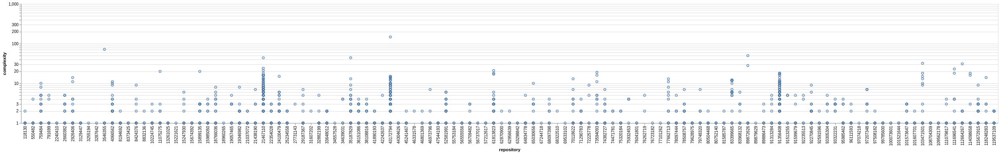

In [68]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(cyc_df).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('complexity', scale=alt.Scale(type="log"), title="complexity")
)
chart

In [69]:
cyc_dfmerged = cyc_df.merge(import_sets_df_simp, left_on='repository', right_on='repo')

In [70]:
cyc_dfmerged

,repository,path,type,rank,endline,complexity,name,col_offset,lineno,classname,error,repo,isML
0,100073601,revtok/subwords.py,method,A,142.0,1.0,__init__,4.0,140.0,SubwordTokenizer,NaN,100073601,False
1,100073601,revtok/tokenizer.py,function,A,61.0,1.0,detokenize,0.0,58.0,NaN,NaN,100073601,False
2,101573647,docs/md_autogen.py,method,A,104.0,1.0,__init__,4.0,93.0,MarkdownAPIGenerator,NaN,101573647,True
3,101573647,docs/update_docs.py,function,A,43.0,1.0,copy_templates,0.0,41.0,NaN,NaN,101573647,True
4,101573647,keras_text/data.py,method,A,110.0,1.0,labels,4.0,108.0,Dataset,NaN,101573647,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2173,97207348,baselines/bilstm/runner.py,function,A,27.0,2.0,shuffle,0.0,18.0,NaN,NaN,97207348,True
2174,97207348,tests/test_bahdanauAttentionLayer.py,method,A,35.0,1.0,test_get_output_for,4.0,11.0,TestBahdanauAttentionLayer,NaN,97207348,True
2175,97207348,tests/test_create_dictionary.py,method,A,27.0,1.0,test_create_dictionary,4.0,7.0,TestCreate_dictionary,NaN,97207348,True
2176,97207348,tests/test_IOBChunker.py,method,A,16.0,1.0,test_chunk,4.0,7.0,TestIOBChunker,NaN,97207348,True


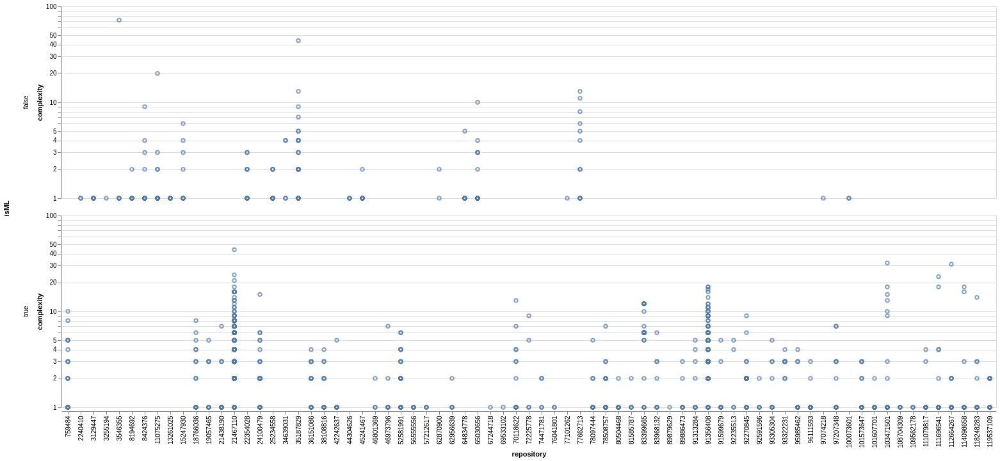

In [72]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(cyc_dfmerged).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('complexity', scale=alt.Scale(type="log"), title="complexity"),
    row = 'isML'
)
chart

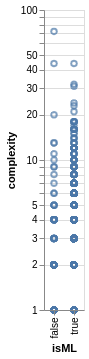

In [74]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(cyc_dfmerged).mark_point().encode(
    y = alt.Y('complexity', scale=alt.Scale(type="log"), title="complexity"),
    x = 'isML'
)
chart

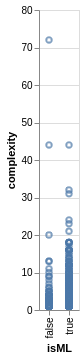

In [155]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(cyc_dfmerged).mark_point().encode(
    y = alt.Y('complexity', title="complexity"),
    x = 'isML'
)
chart

In [142]:
lint_df2merged

,repository,symbol,cnt,repo,isML
0,2240410,anomalous-backslash-in-string,11,2240410,False
1,2240410,attribute-defined-outside-init,4,2240410,False
2,2240410,bad-continuation,1,2240410,False
3,2240410,bad-indentation,1,2240410,False
4,2240410,bad-whitespace,1,2240410,False
...,...,...,...,...,...
2530,119537109,unused-wildcard-import,30,119537109,True
2531,119537109,useless-object-inheritance,21,119537109,True
2532,119537109,useless-return,8,119537109,True
2533,119537109,wildcard-import,11,119537109,True


In [ ]:
lint_df2merged

In [80]:
# All Merged: cyc_df, lint_df2, import_sets_df_simp["isML"]
# TODO: Merge per path/module rather than per repo 

In [81]:
#all_df = import_sets_df_simp.merge(lint_df2, left_on="repo", right_on="repository").merge(cyc_df, left_on="repo", right_on="repository")

In [78]:
#all_df

,repo,isML,repository_x,symbol,cnt,repository_y,path,type,rank,endline,complexity,name,col_offset,lineno,classname,error
0,2240410,False,2240410,anomalous-backslash-in-string,11,2240410,stringparser.py,class,A,36.0,1.0,Dummy,0.0,33.0,NaN,NaN
1,2240410,False,2240410,anomalous-backslash-in-string,11,2240410,tests/stringparser_test.py,method,A,288.0,1.0,test_multiline,4.0,285.0,ParserTest,NaN
2,2240410,False,2240410,attribute-defined-outside-init,4,2240410,stringparser.py,class,A,36.0,1.0,Dummy,0.0,33.0,NaN,NaN
3,2240410,False,2240410,attribute-defined-outside-init,4,2240410,tests/stringparser_test.py,method,A,288.0,1.0,test_multiline,4.0,285.0,ParserTest,NaN
4,2240410,False,2240410,bad-continuation,1,2240410,stringparser.py,class,A,36.0,1.0,Dummy,0.0,33.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133830,119537109,True,119537109,wrong-import-order,3,119537109,utils/metrics/UniqueGram.py,method,A,82.0,1.0,get_ng_fast,4.0,78.0,UniqueGram,NaN
133831,119537109,True,119537109,wrong-import-order,3,119537109,utils/oracle/OracleCfg.py,method,A,83.0,1.0,generate_oracle,4.0,81.0,OracleCfg,NaN
133832,119537109,True,119537109,wrong-import-order,3,119537109,utils/oracle/OracleGru.py,method,A,194.0,1.0,create_output_unit,4.0,184.0,OracleGru,NaN
133833,119537109,True,119537109,wrong-import-order,3,119537109,utils/oracle/OracleLstm.py,method,A,207.0,1.0,create_output_unit,4.0,197.0,OracleLstm,NaN


In [88]:
cyc_df.groupby("repository").median()

,endline,complexity,col_offset,lineno
repository,,,,
118130,80.0,1.0,4.0,76.0
550482,116.5,1.0,4.0,113.5
759484,115.5,1.0,4.0,98.5
791699,28.5,1.0,4.0,22.0
2240410,162.0,1.0,2.0,159.0
...,...,...,...,...
112664267,154.0,1.0,4.0,150.0
114098658,43.0,1.0,4.0,33.5
115672915,119.0,1.0,4.0,103.0


In [89]:
cyc_df.groupby("repository").describe()

endline                                                       \
             count        mean          std   min    25%    50%     75%   
repository                                                                
118130        17.0   86.470588    51.751954  14.0  50.00   80.0  108.00   
550482         8.0  191.625000   276.044478  36.0  44.50  116.5  145.25   
759484        48.0  448.041667  1272.301415   7.0  51.50  115.5  290.50   
791699        10.0   90.500000   131.468839   4.0  14.75   28.5   98.50   
2240410        2.0  162.000000   178.190909  36.0  99.00  162.0  225.00   
...            ...         ...          ...   ...    ...    ...     ...   
112664267     35.0  185.428571   144.632859  15.0  64.00  154.0  285.50   
114098658     32.0   68.125000    77.638845   9.0  32.75   43.0   67.00   
115672915     57.0  163.385965   133.711010  11.0  62.00  119.0  197.00   
118248283     16.0   96.937500    42.805714  16.0  64.75   94.0  132.25   
119537109     51.0  149.039216   121.083766   6.0  63.00   92.0  212.00   

                   complexity            ... col_offset      lineno  \
               max      count      mean  ...        75%  max  count   
repository                               ...                          
118130       211.0       17.0  1.058824  ...        4.0  4.0   17.0   
550482       863.0        8.0  1.375000  ...        4.0  4.0    8.0   
759484      7973.0       48.0  1.833333  ...        4.0  8.0   48.0   
791699       407.0       10.0  1.700000  ...        4.0  4.0   10.0   
2240410      288.0        2.0  1.000000  ...        3.0  4.0    2.0   
...            ...        ...       ...  ...        ...  ...    ...   
112664267    557.0       35.0  1.942857  ...        4.0  4.0   35.0   
114098658    428.0       32.0  2.062500  ...        4.0  5.0   32.0   
115672915    528.0       57.0  1.491228  ...        4.0  4.0   57.0   
118248283    160.0       16.0  2.125000  ...        4.0  4.0   16.0   
119537109    618.0       51.0  1.098039  ...        4.0  4.0   51.0   

                                                                         
                  mean          std   min    25%    50%     75%     max  
repository                                                               
118130       81.882353    50.677759  12.0  47.00   76.0  106.00   207.0  
550482      184.250000   271.453627  25.0  37.75  113.5  143.00   843.0  
759484      440.062500  1273.010444   6.0  34.00   98.5  277.50  7972.0  
791699       85.500000   132.940463   2.0   5.25   22.0   97.50   405.0  
2240410     159.000000   178.190909  33.0  96.00  159.0  222.00   285.0  
...                ...          ...   ...    ...    ...     ...     ...  
112664267   175.200000   146.174915  12.0  45.00  150.0  268.00   556.0  
114098658    57.875000    78.374103   7.0  27.75   33.5   51.25   423.0  
115672915   149.017544   132.784397   6.0  42.00  103.0  195.00   507.0  
118248283    86.750000    45.981880   8.0  49.50   89.5  128.00   147.0  
119537109   143.529412   120.714929   5.0  55.50   91.0  211.00   605.0  

[136 rows x 32 columns]

In [98]:
cyc_df_describe = cyc_df.groupby("repository")["complexity"].describe()
cyc_df_describe

,count,mean,std,min,25%,50%,75%,max
repository,,,,,,,,
118130,17.0,1.058824,0.242536,1.0,1.0,1.0,1.00,2.0
550482,8.0,1.375000,1.060660,1.0,1.0,1.0,1.00,4.0
759484,48.0,1.833333,1.894374,1.0,1.0,1.0,1.25,10.0
791699,10.0,1.700000,1.494434,1.0,1.0,1.0,1.00,5.0
2240410,2.0,1.000000,0.000000,1.0,1.0,1.0,1.00,1.0
...,...,...,...,...,...,...,...,...
112664267,35.0,1.942857,5.063961,1.0,1.0,1.0,1.00,31.0
114098658,32.0,2.062500,3.942633,1.0,1.0,1.0,1.00,18.0
115672915,57.0,1.491228,1.241008,1.0,1.0,1.0,1.00,9.0


In [127]:
cyc_df_describe_flat = pd.DataFrame(cyc_df_describe[["count", "mean", "max"]].to_records())
cyc_df_describe_flat

,repository,count,mean,max
0,118130,17.0,1.058824,2.0
1,550482,8.0,1.375000,4.0
2,759484,48.0,1.833333,10.0
3,791699,10.0,1.700000,5.0
4,2240410,2.0,1.000000,1.0
...,...,...,...,...
131,112664267,35.0,1.942857,31.0
132,114098658,32.0,2.062500,18.0
133,115672915,57.0,1.491228,9.0
134,118248283,16.0,2.125000,14.0


In [100]:
# wrangle so that it can be merged into datafame (let 'cnt' field be arbitrary metric)

In [ ]:
# https://stackoverflow.com/questions/14507794/pandas-how-to-flatten-a-hierarchical-index-in-columns
# lint_df = pd.DataFrame(lint_df.to_records())

In [129]:
cyc_mean_df = pd.DataFrame({"repository": cyc_df_describe_flat["repository"], "symbol": "cyc_mean", "cnt": cyc_df_describe_flat["mean"]})
cyc_mean_df

,repository,symbol,cnt
0,118130,cyc_mean,1.058824
1,550482,cyc_mean,1.375000
2,759484,cyc_mean,1.833333
3,791699,cyc_mean,1.700000
4,2240410,cyc_mean,1.000000
...,...,...,...
131,112664267,cyc_mean,1.942857
132,114098658,cyc_mean,2.062500
133,115672915,cyc_mean,1.491228
134,118248283,cyc_mean,2.125000


In [132]:
cyc_max_df = pd.DataFrame({"repository": cyc_df_describe_flat["repository"], "symbol": "cyc_max", "cnt": cyc_df_describe_flat["max"]})
cyc_max_df

,repository,symbol,cnt
0,118130,cyc_max,2.0
1,550482,cyc_max,4.0
2,759484,cyc_max,10.0
3,791699,cyc_max,5.0
4,2240410,cyc_max,1.0
...,...,...,...
131,112664267,cyc_max,31.0
132,114098658,cyc_max,18.0
133,115672915,cyc_max,9.0
134,118248283,cyc_max,14.0


In [82]:
lint_df2

,repository,symbol,cnt
0,118130,assignment-from-no-return,2
1,118130,attribute-defined-outside-init,13
2,118130,bad-continuation,6
3,118130,bad-indentation,5
4,118130,bad-whitespace,162
...,...,...,...
4449,119537109,unused-wildcard-import,30
4450,119537109,useless-object-inheritance,21
4451,119537109,useless-return,8
4452,119537109,wildcard-import,11


In [136]:
lint_df2_extended = pd.concat([lint_df2, cyc_max_df, cyc_mean_df], ignore_index=True)
lint_df2_extended

,repository,symbol,cnt
0,118130,assignment-from-no-return,2.000000
1,118130,attribute-defined-outside-init,13.000000
2,118130,bad-continuation,6.000000
3,118130,bad-indentation,5.000000
4,118130,bad-whitespace,162.000000
...,...,...,...
4721,112664267,cyc_mean,1.942857
4722,114098658,cyc_mean,2.062500
4723,115672915,cyc_mean,1.491228
4724,118248283,cyc_mean,2.125000


In [137]:
lint_df2_extended_merged = lint_df2_extended.merge(import_sets_df_simp, left_on='repository', right_on='repo')

In [138]:
lint_df2_extended_merged

,repository,symbol,cnt,repo,isML
0,2240410,anomalous-backslash-in-string,11.000000,2240410,False
1,2240410,attribute-defined-outside-init,4.000000,2240410,False
2,2240410,bad-continuation,1.000000,2240410,False
3,2240410,bad-indentation,1.000000,2240410,False
4,2240410,bad-whitespace,1.000000,2240410,False
...,...,...,...,...,...
2676,119537109,wrong-import-order,3.000000,119537109,True
2677,119537109,cyc_max,2.000000,119537109,True
2678,119537109,cyc_mean,1.098039,119537109,True
2679,759484,cyc_max,10.000000,759484,True


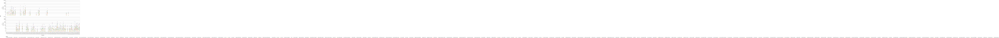

In [139]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2_extended_merged).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('symbol', legend=alt.Legend(title="symbol", orient="bottom")),
    row = 'isML'
)
chart

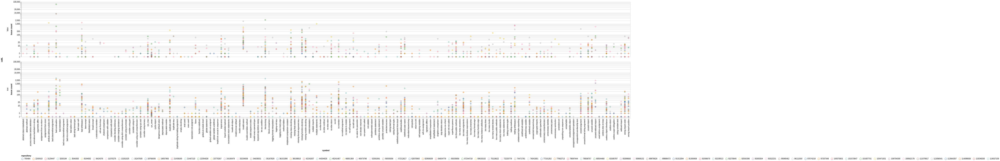

In [140]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(lint_df2_extended_merged).mark_point().encode(
    x = alt.X('symbol', type='ordinal'),
    y = alt.Y('cnt', scale=alt.Scale(type="log"), title="Issue count"),
    color = alt.Color('repository', type='nominal', legend=alt.Legend(title="repository", orient="bottom")),
    row = 'isML'
)
chart

In [131]:
raw_df = pd.read_csv("radon-raw-python3-output.csv",
                     low_memory=False
)


In [132]:
raw_df

,repository,path,loc,lloc,sloc,comments,multi,blank,single_comments,error
0,100073601,setup.py,86.0,8.0,67.0,34.0,0.0,18.0,1.0,NaN
1,100073601,revtok/__init__.py,2.0,2.0,2.0,0.0,0.0,0.0,0.0,NaN
2,100073601,revtok/subwords.py,157.0,132.0,129.0,20.0,0.0,10.0,18.0,NaN
3,100073601,revtok/tokenizer.py,61.0,56.0,50.0,1.0,0.0,10.0,1.0,NaN
4,100073601,test/__init__.py,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...
4719,99785600,code/generator.py,150.0,103.0,102.0,63.0,0.0,20.0,28.0,NaN
4720,99785600,code/main.py,305.0,186.0,189.0,112.0,0.0,31.0,85.0,NaN
4721,99785600,code/utils.py,115.0,81.0,78.0,6.0,25.0,6.0,6.0,NaN
4722,99785600,data/arXiv/abstract_extract.py,49.0,20.0,19.0,2.0,21.0,7.0,2.0,NaN


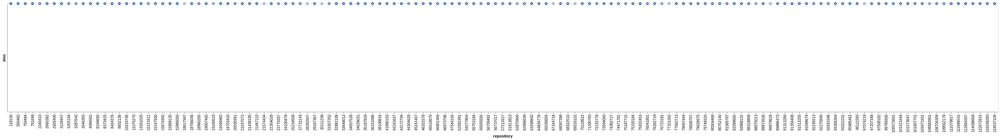

In [142]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    y = alt.Y('sloc', scale=alt.Scale(type="log"), title="sloc")
)
chart

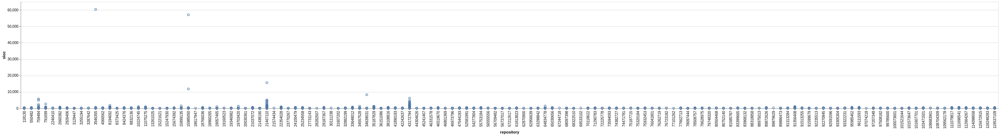

In [143]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df).mark_point().encode(
    x = alt.X('repository', type='nominal'),
    #y = alt.Y('sloc', scale=alt.Scale(type="log"), title="sloc")
    y = alt.Y('sloc', title="sloc")
)
chart

In [139]:
raw_df_merged = raw_df.merge(import_sets_df_simp, left_on='repository', right_on='repo')

In [140]:
raw_df_merged

,repository,path,loc,lloc,sloc,comments,multi,blank,single_comments,error,repo,isML
0,100073601,setup.py,86.0,8.0,67.0,34.0,0.0,18.0,1.0,NaN,100073601,False
1,100073601,revtok/__init__.py,2.0,2.0,2.0,0.0,0.0,0.0,0.0,NaN,100073601,False
2,100073601,revtok/subwords.py,157.0,132.0,129.0,20.0,0.0,10.0,18.0,NaN,100073601,False
3,100073601,revtok/tokenizer.py,61.0,56.0,50.0,1.0,0.0,10.0,1.0,NaN,100073601,False
4,100073601,test/__init__.py,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,100073601,False
...,...,...,...,...,...,...,...,...,...,...,...,...
2855,97207348,baselines/bilstm/runner.py,123.0,89.0,87.0,5.0,5.0,27.0,4.0,NaN,97207348,True
2856,97207348,tests/test_bahdanauAttentionLayer.py,35.0,25.0,25.0,0.0,0.0,10.0,0.0,NaN,97207348,True
2857,97207348,tests/test_create_dictionary.py,27.0,21.0,21.0,0.0,0.0,6.0,0.0,NaN,97207348,True
2858,97207348,tests/test_IOBChunker.py,16.0,13.0,12.0,0.0,0.0,4.0,0.0,NaN,97207348,True


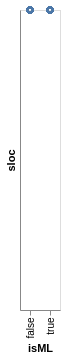

In [144]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df_merged).mark_point().encode(
    y = alt.Y('sloc', scale=alt.Scale(type="log"), title="sloc"),
    x = 'isML'
)
chart

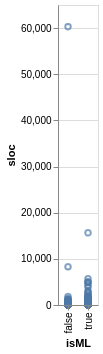

In [146]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df_merged).mark_point().encode(
    y = alt.Y('sloc', title="sloc"),
    x = 'isML'
)
chart

In [159]:
raw_df_merged_with_cyc = raw_df_merged.merge(cyc_df, left_on=['repository', 'path'], right_on=['repository', 'path'])

In [160]:
raw_df_merged_with_cyc

,repository,path,loc,lloc,sloc,comments,multi,blank,single_comments,error_x,...,isML,type,rank,endline,complexity,name,col_offset,lineno,classname,error_y
0,100073601,revtok/subwords.py,157.0,132.0,129.0,20.0,0.0,10.0,18.0,NaN,...,False,method,A,142.0,1.0,__init__,4.0,140.0,SubwordTokenizer,NaN
1,100073601,revtok/tokenizer.py,61.0,56.0,50.0,1.0,0.0,10.0,1.0,NaN,...,False,function,A,61.0,1.0,detokenize,0.0,58.0,NaN,NaN
2,101573647,docs/md_autogen.py,392.0,228.0,253.0,19.0,49.0,71.0,19.0,NaN,...,True,method,A,104.0,1.0,__init__,4.0,93.0,MarkdownAPIGenerator,NaN
3,101573647,docs/update_docs.py,49.0,27.0,37.0,0.0,0.0,12.0,0.0,NaN,...,True,function,A,43.0,1.0,copy_templates,0.0,41.0,NaN,NaN
4,101573647,keras_text/data.py,117.0,65.0,60.0,0.0,31.0,26.0,0.0,NaN,...,True,method,A,110.0,1.0,labels,4.0,108.0,Dataset,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2173,97207348,baselines/bilstm/runner.py,123.0,89.0,87.0,5.0,5.0,27.0,4.0,NaN,...,True,function,A,27.0,2.0,shuffle,0.0,18.0,NaN,NaN
2174,97207348,tests/test_bahdanauAttentionLayer.py,35.0,25.0,25.0,0.0,0.0,10.0,0.0,NaN,...,True,method,A,35.0,1.0,test_get_output_for,4.0,11.0,TestBahdanauAttentionLayer,NaN
2175,97207348,tests/test_create_dictionary.py,27.0,21.0,21.0,0.0,0.0,6.0,0.0,NaN,...,True,method,A,27.0,1.0,test_create_dictionary,4.0,7.0,TestCreate_dictionary,NaN
2176,97207348,tests/test_IOBChunker.py,16.0,13.0,12.0,0.0,0.0,4.0,0.0,NaN,...,True,method,A,16.0,1.0,test_chunk,4.0,7.0,TestIOBChunker,NaN


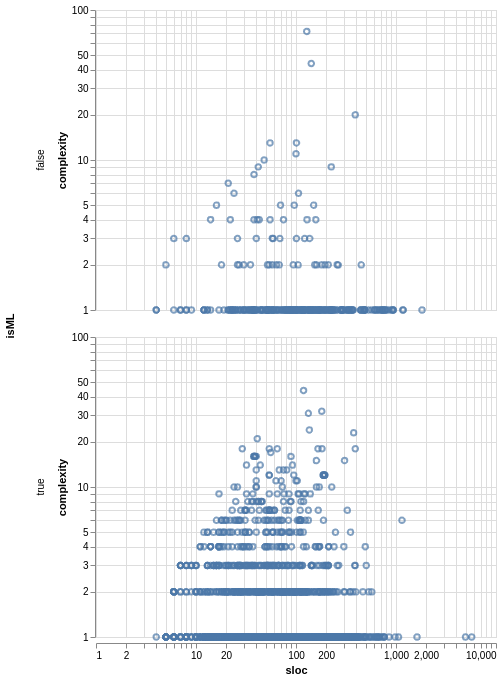

In [169]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df_merged_with_cyc).mark_point().encode(
    x = alt.X('sloc', title="sloc", scale=alt.Scale(type="log")),
    y = alt.Y('complexity', title="complexity", scale=alt.Scale(type="log")),
    row = 'isML'
)
chart

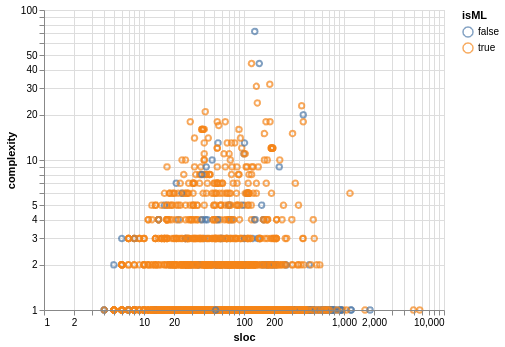

In [168]:
# following https://vega.github.io/vega-lite/examples/circle_natural_disasters.html
chart = alt.Chart(raw_df_merged_with_cyc).mark_point().encode(
    x = alt.X('sloc', title="sloc", scale=alt.Scale(type="log")),
    y = alt.Y('complexity', title="complexity", scale=alt.Scale(type="log")),
    color = 'isML'
)
chart